# An Introduction to PySTAC for Remote Sensing
## Mikael Brunila<br>Geographic Information Centre (McGill)
### February 2025

# Overview

- **Part 1: Introduction** (15 min)
  - Issues with remote sensing (RS) data
  - What is STAC?
  - What is PySTAC?
- **Part 2: Code demo** (30 min)
  - Finding buildings in the Palisades Fire area in LA using Sentinel-2 data
- **Part 3: Hands-on** (45 min+)
  - Finding *burned* buildings in the Palisades Fire area in LA using Sentinel-2 data

# Part 1: Introduction

## Remote Sensing

Remote sensing is the process of detecting and collecting information of the physical characteristics of or on the Earth without making contact with the area.

There are today more than 4550 (as of 2021) satellites orbiting the Earth. They gather data at various resolutions (including very fine).

Most of these satellites are private. 

- 3,790 for communication purposes and “earth observations” 


## Remote Sensing Data

Remote sensing data is often stored in very large image files of high-resolution formats like `.tif`.

Storing this data in very unwieldy. 

# STAC: Spatio-Temporal Asset Catalog

A "common language to describe geospatial information".

Provides standards for storing, indexing, and accessing geospatial data in general and satellite RS data in particular.

JSON-files that are organized in a hierarchy:

- Item (individual images)
- Collection (sets of images)
- Catalog (connects sets of images)

# STAC: Item

A STAC Item represents ***one* captured image**, e.g., a Sentinel-2 scene over New York on 2024-06-15.

<img src="img/STAC-Item.jpeg" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)*<br>

# STAC: Item

<img src="img/geojson-example.png" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Collection

A STAC Collection groups multiple Sentinel-2 images together. It defines shared metadata like temporal coverage and data sources.

<img src="img/STAC-Collection.png" alt="Drawing" style="width: 75%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Catalog

A STAC Catalog is a higher-level structure that links different collections (e.g., Sentinel-2, Landsat, NAIP).

<img src="img/STAC-Catalog.jpeg" alt="Drawing" style="width: 50%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Catalog

<img src="img/Catalog-layout.jpeg" alt="Drawing" style="width: 50%;"/>

*Source: [The STAC Specification](https://stacspec.org/en/tutorials/intro-to-stac/)* <br>

## STAC: Programming Languages and Frameworks 

- Python: [pystac](https://github.com/stac-utils/pystac)
- JavaScript: [stac-server](https://github.com/stac-utils/stac-server)
- Rust: [stac-rs](https://github.com/stac-utils/stac-rs)
- R: [rstac](https://github.com/brazil-data-cube/rstac)
- QGIS: [qgis-stac-plugin](https://github.com/stac-utils/qgis-stac-plugin)

# Part 2: Code Demo

## The LA 2025 Fires

- From January 7th to 31st
- Killed 28+ people (wite 31+ more still missing) and forced 200,000+ to evacuate
- Destroyed 18,189+ buildings
- Concentrated in the Altadena and Pacific Palisades neighborhoods

## Our Case Study: The Palisades Fire

- Pacific Palisades
- Killed 12 people (with 7 more still missing) and forced 105,000 to evacuate
- Destroyed 6,837 buildings, damaged 1,017

## Our Case Study: The Palisades Fire

- Researchers at CUNY and Oregon State University used data from the Sentinel-1 and Sentinel-2 satellites to assess the damage
- We will try to replicate part of the study by using Sentinel-2 data

<img src="img/Corey_Scher_LA_Wildfires_Map_2560px.jpg" alt="Drawing" style="width: 50%;"/>

*Source: [How and Why a CUNY Graduate Center Student Maps the Devastation of Wildfires and War](https://www.gc.cuny.edu/news/how-and-why-cuny-graduate-center-student-maps-devastation-wildfires-and-war)* <br>

## Spectral Indexes

$NDVI = \frac{\text{NIR} - \text{Red}}{\text{NIR} + \text{Red}}$


## Spectral Indexes for Analysing Structural Fire Damage

For our analysis, we want to:

1. Preprocess by removing big bodies of water such as the ocean
2. Identify buildings
3. Identify areas that were burned *after* the fire
4. Find the overlap between buildings and burned areas

## Removing water: NDWI

The Normalized Difference Water Index (NDWI) is a remote sensing technique that detects and monitors changes in water content in bodies of water. 

$NDWI = \frac{\text{Green} - \text{NIR}}{\text{Green} + \text{NIR}}$

## Identifying buildings: NDBI

The Normalized Difference Built-up Index (NDBI) is a remote sensing index used to identify and distinguish built-up areas like cities and urban environments from other land covers by calculating the difference between the reflectance values in the shortwave infrared (SWIR) and near-infrared (NIR) bands of a satellite image, with higher positive values indicating more built-up areas; essentially, it highlights areas with a high reflection of SWIR compared to NIR, which is typical of buildings and concrete surfaces. 


$NDBI = \frac{\text{SWIR} - \text{NIR}}{\text{SWIR} + \text{NIR}}$

$NBAI = \frac{\text{SWIR}_1 - (\text{Red} + \text{Green} + \text{Blue})}{\text{SWIR}_1 + (\text{Red} + \text{Green} + \text{Blue})}$

$NBR = \frac{\text{NIR} - \text{SWIR}_2}{\text{NIR} + \text{SWIR}_2}$

# PySTAC

The most active and comprehensive framework for accessing STAC assets. Our full workflow will use:

### Accessing catalogues
- pystac_client

### Browsing and filtering 
- pystac
- shapely

### Loading and processing data
- odc-stac
- xarray
- numpy

### Visualizing data
- ipyleaflet
- geopandas
- matplotlib

## Install and load libraries

In [77]:
import folium
import geopandas as gpd
import ipyleaflet
import matplotlib.pyplot as plt
import pystac_client
import shapely

from IPython.display import Image
from odc.stac import load
from shapely import Polygon
from shapely.geometry import box
from tqdm import tqdm

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load helper functions

In [78]:
from utils import *

## Access and browse the catalog 

- PyStac allows us to directly access some of these resources as they are stored by actors such as AWS, Google, and Microsoft. 
- We will use data as provided by the AWS affiliated company Element84. 
- There are a few other providers that give access to the same data.

In [4]:
sentinel_client = pystac_client.Client.open("https://earth-search.aws.element84.com/v1")

Once we've established the connection to Element84, we can check what data and from which satellites do we have access to.

In [5]:
collections = list(sentinel_client.get_collections())
n_collections = len(collections)

In [6]:
print(f"There are {n_collections} collections:\n")
for c in collections:
    print(c.id)

There are 9 collections:

sentinel-2-pre-c1-l2a
cop-dem-glo-30
naip
cop-dem-glo-90
landsat-c2-l2
sentinel-2-l2a
sentinel-2-l1c
sentinel-2-c1-l2a
sentinel-1-grd


There are three different satellites 

1. Data from the Sentinel missions of the Copernicus program: ```sentinel-2-pre-c1-l2a```, ```sentinel-2-l2a```, ```sentinel-2-l1c```, ```sentinel-2-c1-l2a```, ```sentinel-1-grd```
2. Data from the TanDEM-X mission of the Copernicus program: ```cop-dem-glo-30``` \& ```cop-dem-glo-90```
3. Data from the [National Agriculture Imagery Program (NAIP)](https://naip-usdaonline.hub.arcgis.com/): ```naip```
4. Data from the [Landsat program](https://www.usgs.gov/landsat-missions/landsat-collection-2-level-2-science-products): ```landsat-c2-l2```

## Sentinel-2

We will use the [sentinel-2-l2a dataset](https://docs.sentinel-hub.com/api/latest/data/sentinel-2-l2a/). This dataset has a few advantegous properties. It is:

1. Available at a good resolution. 10 m, 20 m, and 60 m depending on wavelength
2. Uses a MultiSpectral Instrument (MSI) with 13 bands: 4 visible bands, 6 Near-Infrared bands, 3 Short-Wave Infrared bands
3. Available at a frequent interval: Collected every 5 days
4. Available at ```"l2a"```, i.e. atmospherically corrected surfance reflectance

![](img/sentinel_2_revisit_freq.png)
*Source: https://sentiwiki.copernicus.eu/web/s2-mission*

Moreover:
- It is available at land and coastal areas between latitudes 56°S and 83°N
- Global data available since January 2017, some local patches since October 2016

In [7]:
collection = "sentinel-2-l2a"

## Explore the available data

This data is available almost "real time". We can, for instance, easily get data for January and February in February of the year this was written (2025).

In [8]:
date = "2025-02-01/2025-02-14"

Before accessing the satellite data, we have to choose a specific area of interest (AOI). We can use the package ```ipyleaflet``` to visualize a point in the Wet'suwet'en territory.

In [9]:
m = ipyleaflet.Map()
m.center = 34.05, -118.55
m.zoom = 14
m.layout.height = "600px"
m.layout.width = "1200px"
m

Map(center=[34.05, -118.55], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom…

This preview can *directly* be used to get the "bounding box" (bbox) of our AOI.

In [10]:
bbox=[m.west, m.south, m.east, m.north]

Now, using this bbox and our dates of interest, we can retrieve information *about* the images that are available for that AOI at that time.

We run our query with three filters we want images with

1. less than 20% of their pixels missing.
2. less than 20% degraded spectral data.
3. less than 20% cloud cover.

Additionally, we recommend the service return only 5 images.

In [11]:
%%time
item_search_t1 = sentinel_client.search(collections=[collection], # Filter by collection
                                 datetime=date, # Filter by date
                                 bbox=bbox, # Filter by area
                                 query=["s2:nodata_pixel_percentage<20",
                                        "s2:degraded_msi_data_percentage<20",
                                        "eo:cloud_cover<20"], # Filter by quality
                                 limit=5) # Limit n returned images to 5

CPU times: user 534 µs, sys: 30 µs, total: 564 µs
Wall time: 568 µs


What we get in return is a PyStac ```ItemSearch```. This is like getting the search results of Google. You haven't yet loaded the data of the websites returned by your search, only some data *about* each website.

Similarly, we now have data *about* the relevant images, not yet the images.

Why? Because these images are HUGE! You could easily end up downloading tens of gigabytes by accident.

In [12]:
item_search_t1.item_collection()

In [13]:
item_collection_t1 = item_search_t1.item_collection()

In [14]:
n_items_t1 = len(item_collection_t1)
n_items_t1

1

Before downloading the actual images, we can use the `geopandas`, `shapely`, and `folium` packages the size and various properties of our images of interest.

Here, we look at the water percentage of each image. It's an arbitrary attribute, but it shows how the images correspond to the underlying map :) 

In [15]:
gdf = gpd.GeoDataFrame.from_features(
    item_collection_t1.to_dict(), 
    crs="EPSG:4326"
)
bbox_geom = shapely.geometry.mapping(shapely.geometry.box(*bbox))
bbox_layer = folium.GeoJson(bbox_geom)

m = gdf.explore(column="eo:cloud_cover", syle_kwds={"fillOpacity": 0.1})
bbox_layer.add_to(m)
m

The search itself is a generator object that includes metadata for all the items returned for the query.

In [16]:
item_search_t1.items()

<generator object ItemSearch.items at 0x12cbc8200>

In [17]:
list(item_search_t1.items())

[<Item id=S2C_11SLT_20250201_0_L2A>]

Using a custom function, we can print some attributes of each image.

In [18]:
print_item_search_attributes(item_search_t1)

1 items found:

ID: S2C_11SLT_20250201_0_L2A 
 Cloud cover (%): 15.756986 
 Missing pixels (%): 0 
 Missing band data (%): 0.0213 
 Image area (km^2): 1.17 



## Time 1: Working with one item

Before working with the whole set of items, let's take a look at just one image. We'll pick the one with the least cloud cover. This is our "$t_1$", data from the current moment or "time one".

In [19]:
items_t1 = list(item_collection_t1)

In [20]:
min_cloud_t1 = get_item_with_min_attribute(items_t1, attr='eo:cloud_cover')
min_cloud_t1.properties['datetime']

'2025-02-01T18:45:30.242000Z'

Before loading the item, we can access a low resolution "thumbnail" image to preview it.

In [21]:
Image(url=min_cloud_t1.assets["thumbnail"].href, width=400)

The image is very low res, but it gives us a sense of what's to come.

### Item Assets ($t_1$)

In [22]:
print_assets(min_cloud_t1)

aot | Aerosol optical thickness (AOT)
blue | Blue - 10m
cloud | Cloud Probabilities
coastal | Coastal - 60m
granule_metadata | None
green | Green - 10m
nir | NIR 1 - 10m
nir08 | NIR 2 - 20m
nir09 | NIR 3 - 60m
product_metadata | None
red | Red - 10m
rededge1 | Red Edge 1 - 20m
rededge2 | Red Edge 2 - 20m
rededge3 | Red Edge 3 - 20m
scl | Scene classification map (SCL)
snow | Snow Probabilities
swir16 | SWIR 1.6μm - 20m
swir22 | SWIR 2.2μm - 20m
tileinfo_metadata | None
visual | True color image
wvp | Water Vapour (WVP)
thumbnail | Thumbnail of preview image
aot-jp2 | Aerosol optical thickness (AOT)
blue-jp2 | Blue - 10m
coastal-jp2 | Coastal - 60m
green-jp2 | Green - 10m
nir-jp2 | NIR 1 - 10m
nir08-jp2 | NIR 2 - 20m
nir09-jp2 | NIR 3 - 60m
red-jp2 | Red - 10m
rededge1-jp2 | Red Edge 1 - 20m
rededge2-jp2 | Red Edge 2 - 20m
rededge3-jp2 | Red Edge 3 - 20m
scl-jp2 | Scene classification map (SCL)
swir16-jp2 | SWIR 1.6μm - 20m
swir22-jp2 | SWIR 2.2μm - 20m
visual-jp2 | True color image
wvp

### Selecting Assets and Area ($t_1$)

Recall, that we are interested in four different types of imagery:

- RGB (red, green, blue), i.e. "standard" photography
- The Normalized Difference Vegetation Index (NDVI), which required the red and near-infrared (NIR) bands
- The ...

So, we pick the following bands:

In [23]:
selected_bands = ["swir16", "swir22","nir","red","green","blue"]

All of these are available at either the 10m or 20m resolution!

## Getting the appropriate polygon ($t_1$)

We are still only dealing with descriptions of our data, *not* the actual data. 

Before we load the data, recall that the images of interestet were MUCH larger than our area of interest. So we want to filter and only load part of each image. 

To do this, we find the intersection polygons between (1) each image of interest and (2) the total area of interest.

For our example image, the bounds of the image can be found like this, using the Python package `shapely`:

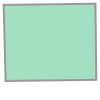

In [24]:
min_cloud_t1_poly = Polygon(*min_cloud_t1.geometry['coordinates'])
min_cloud_t1_poly

For the bbox of our total AOI, like this:

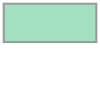

In [25]:
bbox_poly = box(*bbox)
bbox_poly

Now, we can use `shapely` to find their intersection.

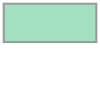

In [26]:
intersection_poly = shapely.intersection(
    bbox_poly,
    min_cloud_t1_poly)

intersection_poly

For our example image, *this* is the part of the image that we want to retrieve!

In [27]:
min_cloud_t1.geometry

{'type': 'Polygon',
 'coordinates': [[[-119.17376896599782, 34.32235671057083],
   [-119.14885662021419, 33.33277630652224],
   [-117.96938626406873, 33.34758667242361],
   [-117.98063319821665, 34.33772750342932],
   [-119.17376896599782, 34.32235671057083]]]}

In [28]:
min_cloud_t1

<Item id=S2C_11SLT_20250201_0_L2A>

### Load the Item into Memory ($t_1$)

To reiterate. 

To actually get the data and not just a description of it, we need to "load" it. 

- We only pick the relevant bands
- We limit the image to the intersection polygon
- We lower the resolution

Now we can actually retrieve our example image using the `stac_load` function from the helper library `odc.stac`.

In [29]:
from odc.stac import stac_load

In [30]:
data_t1 = stac_load([min_cloud_t1], 
                    bands = selected_bands,
                    bbox=intersection_poly.bounds,
                    crs="EPSG:32611",
                    chunks={},
                    #resolution=0.5, #could be as low as 0.00009009
                    progress=tqdm).isel(time=0)

data_t1

<xarray.Dataset> Size: 6MB
Dimensions:      (y: 489, x: 959)
Coordinates:
  * y            (y) float64 4kB 3.771e+06 3.771e+06 ... 3.766e+06 3.766e+06
  * x            (x) float64 8kB 3.521e+05 3.522e+05 ... 3.617e+05 3.617e+05
    spatial_ref  int32 4B 32611
    time         datetime64[ns] 8B 2025-02-01T18:45:30.242000
Data variables:
    swir16       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    swir22       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    nir          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    red          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    green        (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    blue         (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>

## RGB visualization ($t_1$)

Normally, RGB data is expressed on the 0 to 255 or 0 to 1 range. That's no the case with Sentinel-2 data, so we normalize it into the 0, 255 range.

In [31]:
normalized_rgb_t1 = normalize_to_rgb(data_t1)
normalized_rgb_t1.shape

(489, 959, 3)

Now we can get a regular RGB image of the intersection polygon we are interested in.

Text(0.5, 1.0, 'The Pacific Palisades in LA after the January 2025 Fires')

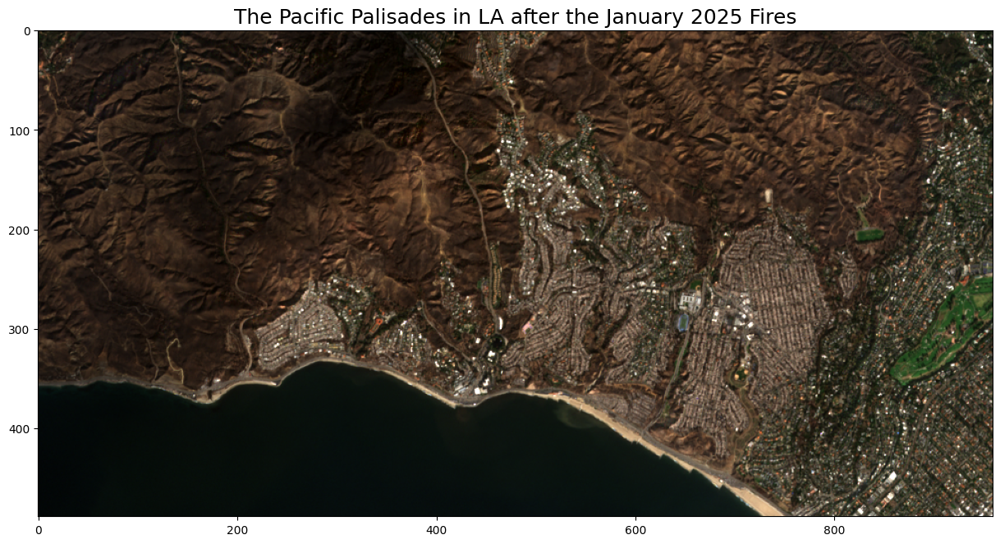

In [32]:
fig, ax = plt.subplots(figsize=(15, 15))

cax = ax.imshow(normalized_rgb_t1)
ax.set_title("The Pacific Palisades in LA after the January 2025 Fires", size=18)

We can see that the hills are burned brown, in stark contrast to the green landscape in the lower-right corner.

## Calculating Spectral Indices ($t_1$)

While we an see pipeline here because we *know* it's there, we could use NDVI to find something similar we are unaware of. The formula for NDVI is: 

$NDVI = \frac{(nir - red)}{(nir + red)}$

In code, this can be written as

In [33]:
def return_ndvi(data:xr.Dataset) -> xr.DataArray:
    """
    Calculate and return NDVI.
    """

    # Turn red band into floats
    red = data["red"].astype("float") 

    # Turn near infrared band into floats
    nir = data["nir"].astype("float")

    # Calculate NDVI
    ndvi = (nir - red) / (nir + red) 
    return ndvi

In [34]:
# Compute NDVI (Normalized Difference Vegetation Index)
ndvi = return_ndvi(data_t1)

In [36]:
from spectral_indexes import *

# Compute NDWI (Modified NDWI: using green and SWIR)
ndwi = return_ndwi(data_t1)

# Compute NDBI (Normalized Difference Built-Up Index)
ndbi = return_ndbi(data_t1)

# Compute NBAI (Normalized Built-Up Area Index)
# This example uses SWIR and Green bands to highlight built-up areas
nbai = return_nbai(data_t1)

ibi = return_ibi(data_t1)
#ebbi = return_ebbi(data_t1)

## Visualizing Spectral Indices ($t_1$)

Using ```matplotlib```, we can plot the NDVI values for T1 like so.

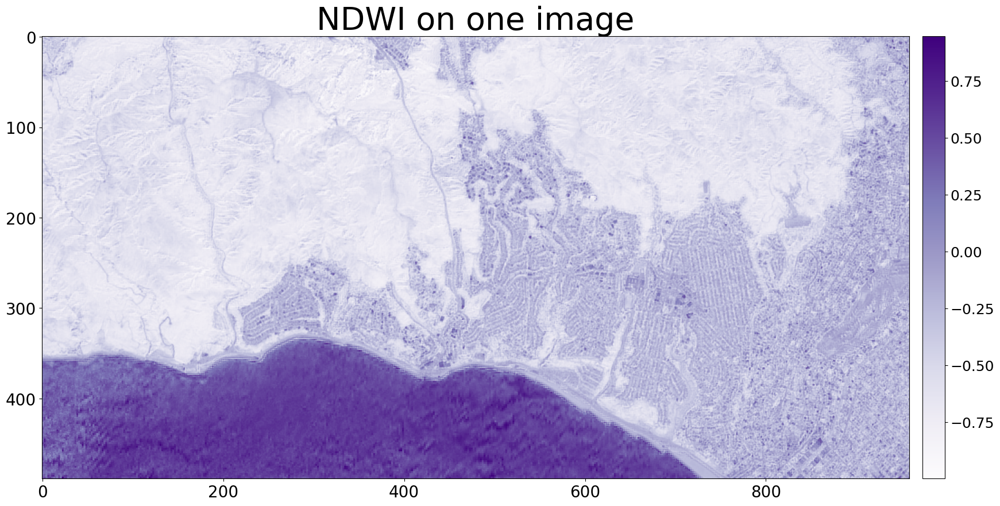

In [37]:
plot_single_image_spectral_idx(ndwi, 30, 10, name = "NDWI", cmap="Purples")

In [38]:
water_mask_t1 = ndwi > 0.1

ndvi_water_masked = np.where(water_mask_t1, np.nan, ndvi)
ndbi_water_masked = np.where(water_mask_t1, np.nan, ndbi)
nbai_water_masked = np.where(water_mask_t1, np.nan, nbai)

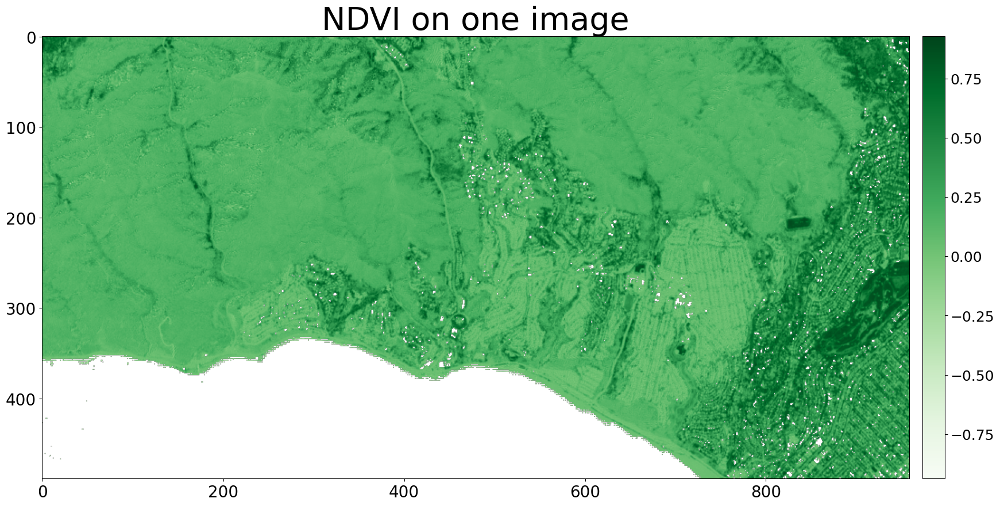

In [39]:
plot_single_image_spectral_idx(ndvi_water_masked, 30, 10, name = "NDVI")

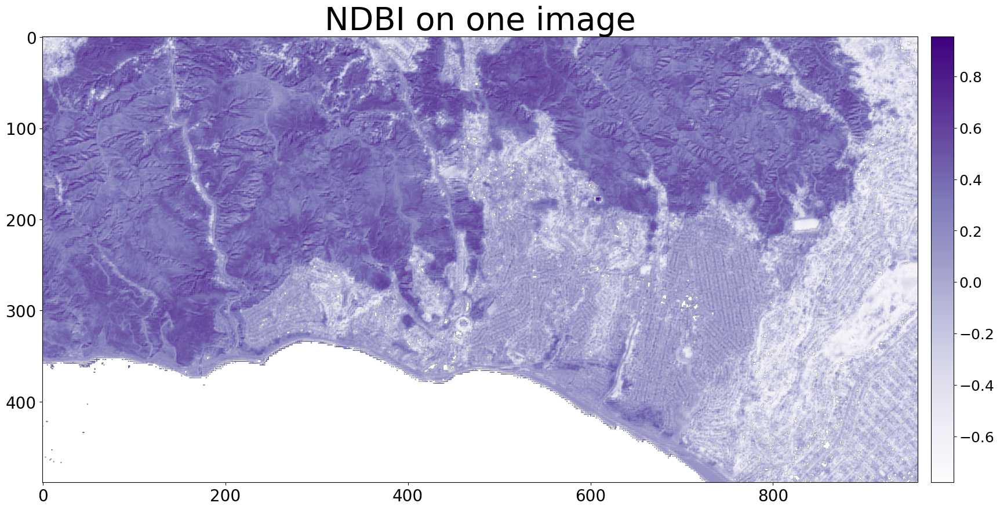

In [40]:
plot_single_image_spectral_idx(ndbi_water_masked, 30, 10, name = "NDBI", cmap="Purples")


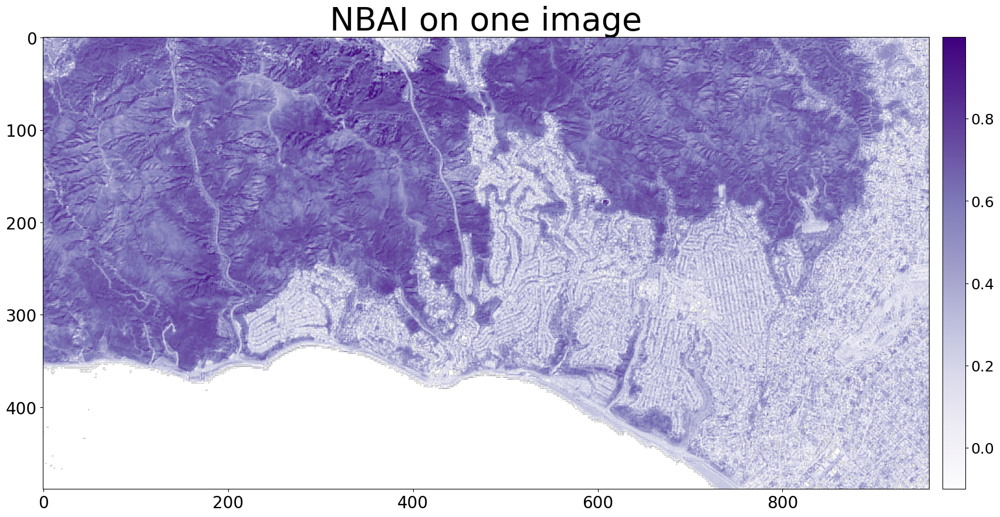

In [41]:
plot_single_image_spectral_idx(nbai_water_masked, 30, 10, name = "Reds", cmap="Purples")


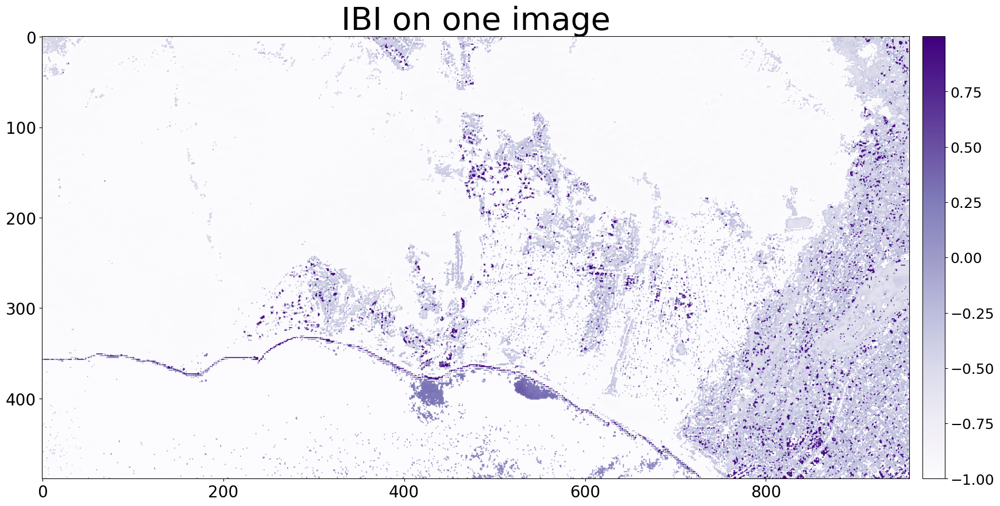

In [43]:
plot_single_image_spectral_idx(ibi, 30, 10, name = "IBI", cmap="Purples")

## Spectral index median values ($t_1$)

In [44]:
item_list_t1 = list(item_collection_t1)

In [46]:
ndvis_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_ndvi)
nbais_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_nbai)
ibis_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_ibi)
nbrs_t1 = calculate_spectral_index_over_items(item_list_t1, selected_bands, bbox, return_nbr)

Processing item 1 out of 1


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:13<00:00, 12.32s/it]


Processing item 1 out of 1


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:07<00:00, 11.19s/it]


Processing item 1 out of 1


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:16<00:00, 12.71s/it]


Processing item 1 out of 1


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:15<00:00, 12.52s/it]


In [47]:
%time median_ndvi_t1 = calculate_median_index(ndvis_t1)
%time median_nbai_t1 = calculate_median_index(nbais_t1)
%time median_ibi_t1 = calculate_median_index(ibis_t1)
%time median_nbr_t1 = calculate_median_index(nbrs_t1)

Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 19 ms, sys: 4.45 ms, total: 23.4 ms
Wall time: 22.7 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 16 ms, sys: 1.49 ms, total: 17.5 ms
Wall time: 17.5 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 15.2 ms, sys: 2.11 ms, total: 17.4 ms
Wall time: 17.4 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 17.4 ms, sys: 3.02 ms, total: 20.5 ms
Wall time: 20.5 ms


In [48]:
median_ndvi_t1_np = xr_spectral_index_data_to_np(median_ndvi_t1)
median_nbai_t1_np = xr_spectral_index_data_to_np(median_nbai_t1)
median_ibi_t1_np = xr_spectral_index_data_to_np(median_ibi_t1)
median_nbr_t1_np = xr_spectral_index_data_to_np(median_nbr_t1)

## Plot Spectral Medians ($t_1$)

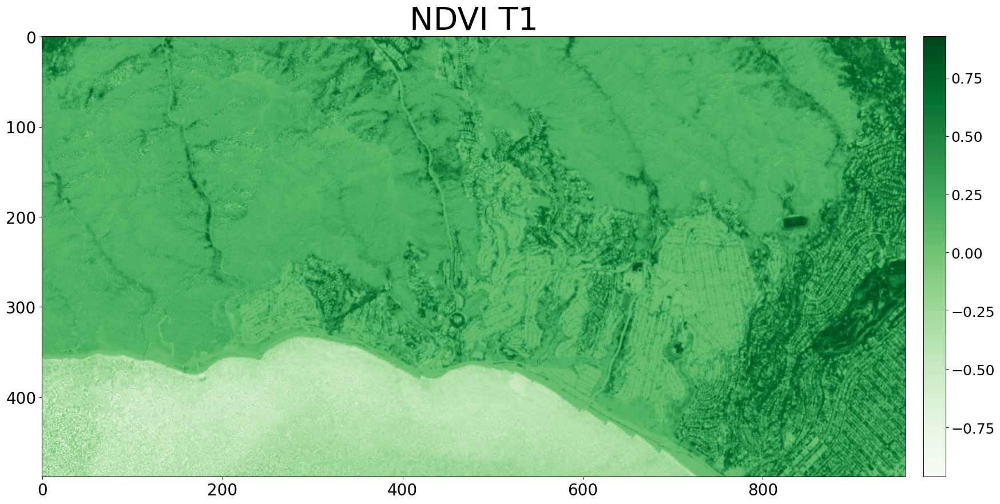

In [49]:
plot_territory(median_ndvi_t1_np, 30, 10, 'Greens', 'NDVI T1')

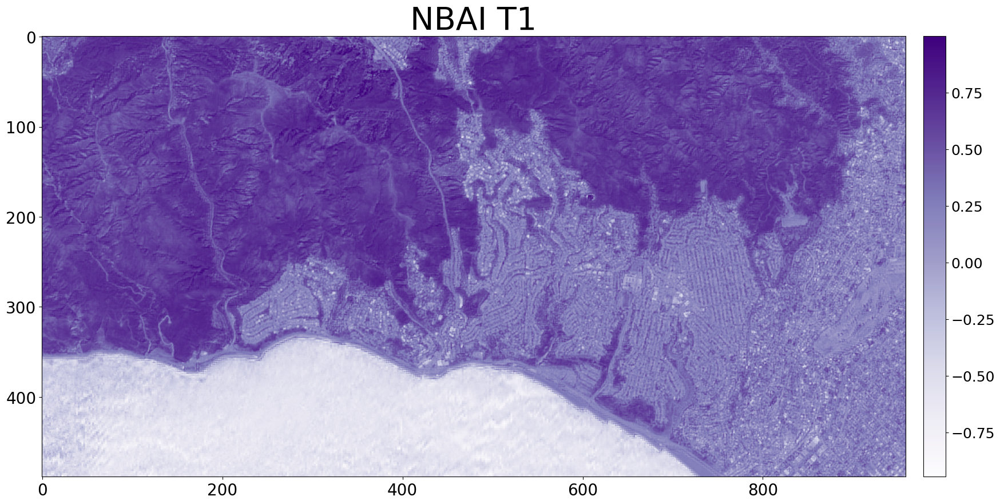

In [50]:
plot_territory(median_nbai_t1_np, 30, 10, 'Reds', 'NBAI T1')

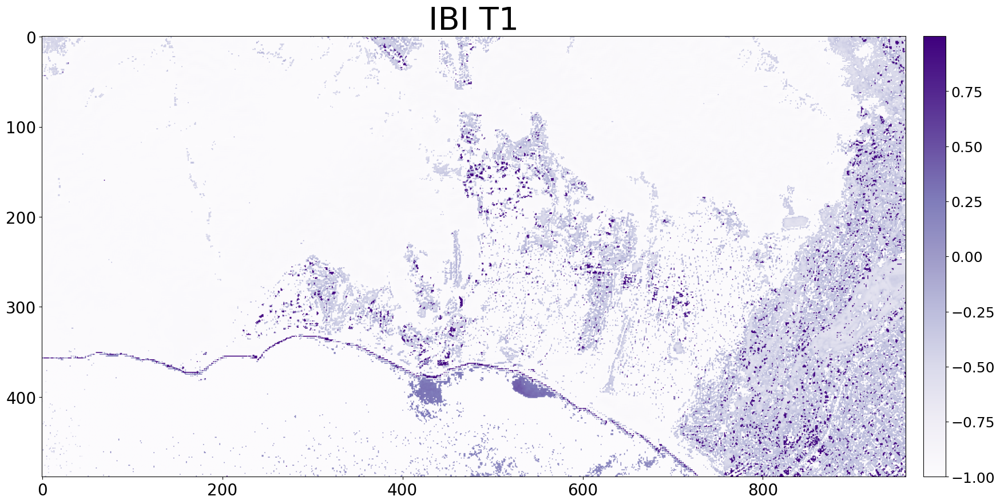

In [52]:
plot_territory(median_ibi_t1_np, 30, 10, 'Purples', 'IBI T1')

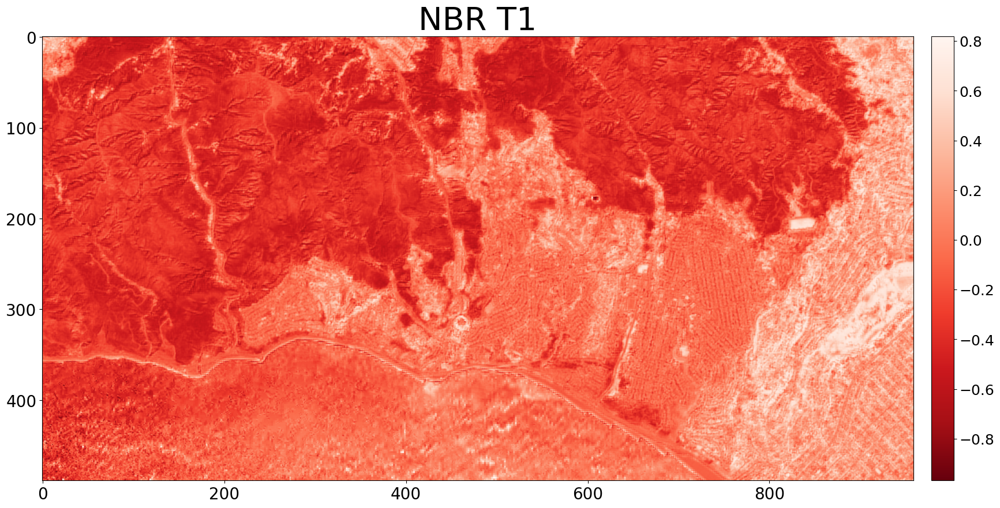

In [51]:
plot_territory(median_nbr_t1_np, 30, 10, 'Reds_r', 'NBR T1')

# Part 2: Hands-on

## Spectral Index change detection ($t_1$ - $t_0$)

### Choosing your $t_0$

In [53]:
dates_t0 = "2024-12-01/2025-01-06"

In [57]:
%%time
item_search_t0 = sentinel_client.search(
    collections=[collection], 
    datetime=dates_t0,
    bbox=bbox,
    query=["s2:nodata_pixel_percentage<20",
           "s2:degraded_msi_data_percentage<20",
           "eo:cloud_cover<20"],
    max_items = 5)

CPU times: user 382 µs, sys: 10 µs, total: 392 µs
Wall time: 395 µs


In [58]:
print_item_search_attributes(item_search_t0)

2 items found:

ID: S2A_11SLT_20250102_0_L2A 
 Cloud cover (%): 3.015763 
 Missing pixels (%): 7e-06 
 Missing band data (%): 0 
 Image area (km^2): 1.17 

ID: S2B_11SLT_20241218_0_L2A 
 Cloud cover (%): 0.004997 
 Missing pixels (%): 0 
 Missing band data (%): 0.0213 
 Image area (km^2): 1.17 



In [59]:
item_collection_t0 = item_search_t0.item_collection()

In [60]:
items_t0 = list(item_collection_t0)
items_t0[0].properties['datetime']

'2025-01-02T18:45:02.738000Z'

### Detour: Fixing Item Properties ($t_0$)

In [61]:
def print_item_properties(item, string:str="proj"):
    for key, value in item.properties.items():
        if string in key:
            print(f"{key}:{value}")
            
def fix_item_proj_properties(source, target, string:str="proj"):
    for key, value in source.properties.items():
        if string in key:
            target.properties[key] = value
    return target

In [62]:
print_item_properties(items_t0[0])

proj:epsg:32611


In [63]:
print_item_properties(min_cloud_t1)

proj:code:EPSG:32611
proj:centroid:{'lat': 33.83606, 'lon': -118.56814}


In [64]:
items_t0 = [fix_item_proj_properties(min_cloud_t1, item, "proj") for item in list(items_t0)]
items_t0

[<Item id=S2A_11SLT_20250102_0_L2A>, <Item id=S2B_11SLT_20241218_0_L2A>]

## Load Item ($t_0$)

In [65]:
min_cloud_t0 = get_item_with_min_attribute(items_t0, attr='eo:cloud_cover')

In [66]:
data_t0 = stac_load([min_cloud_t0], 
                    bands = selected_bands,
                    bbox=intersection_poly.bounds,
                    crs="EPSG:32611",
                    chunks={},
                    #resolution=0.5, #could be as low as 0.00009009
                    progress=tqdm).isel(time=0)

data_t0

<xarray.Dataset> Size: 6MB
Dimensions:      (y: 489, x: 959)
Coordinates:
  * y            (y) float64 4kB 3.771e+06 3.771e+06 ... 3.766e+06 3.766e+06
  * x            (x) float64 8kB 3.521e+05 3.522e+05 ... 3.617e+05 3.617e+05
    spatial_ref  int32 4B 32611
    time         datetime64[ns] 8B 2024-12-18T18:45:03.766000
Data variables:
    swir16       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    swir22       (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    nir          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    red          (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    green        (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>
    blue         (y, x) uint16 938kB dask.array<chunksize=(489, 959), meta=np.ndarray>

In [67]:
normalized_rgb_t0 = normalize_to_rgb(data_t0)
normalized_rgb_t0.shape

(489, 959, 3)

Text(0.5, 1.0, 'The Pacific Palisades in LA before the January 2025 Fires')

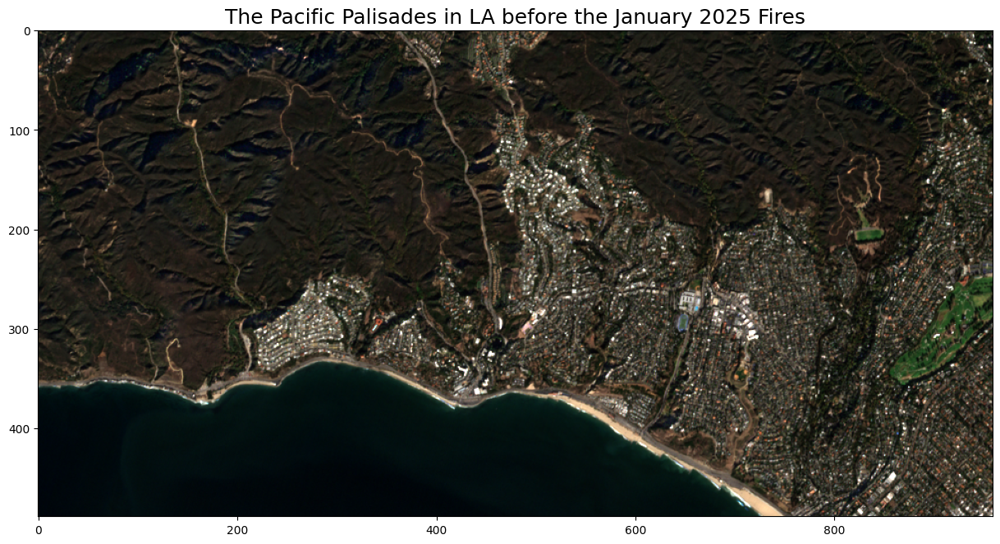

In [68]:
fig, ax = plt.subplots(figsize=(15, 15))

cax = ax.imshow(normalized_rgb_t0)
ax.set_title("The Pacific Palisades in LA before the January 2025 Fires", size=18)

Text(0.5, 1.0, 'The Pacific Palisades in LA After the January 2025 Fires')

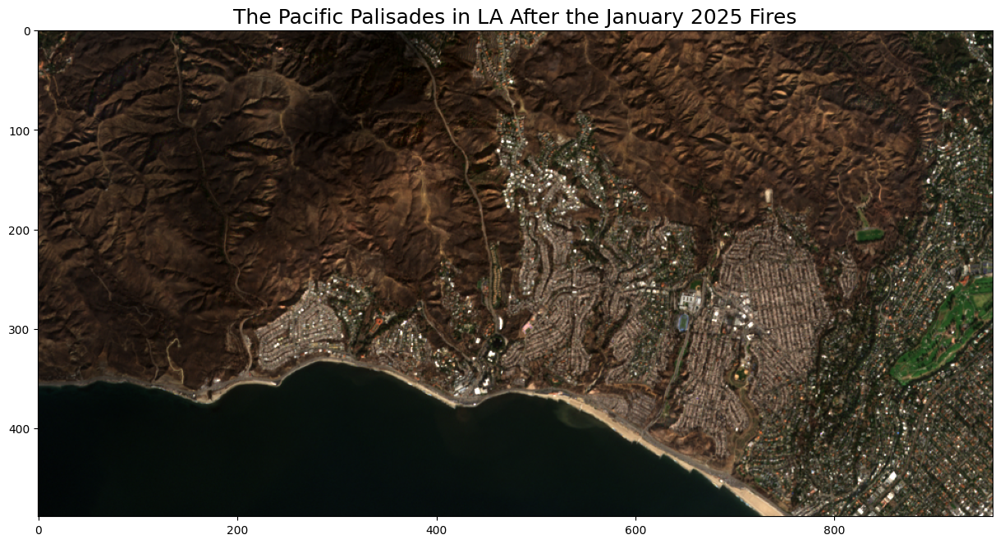

In [69]:
fig, ax = plt.subplots(figsize=(15, 15))

cax = ax.imshow(normalized_rgb_t1)
ax.set_title("The Pacific Palisades in LA After the January 2025 Fires", size=18)

In [70]:
ndvis_t0 = calculate_spectral_index_over_items(items_t0, selected_bands, bbox, return_ndvi)
nbais_t0 = calculate_spectral_index_over_items(items_t0, selected_bands, bbox, return_nbai)
ibis_t0 = calculate_spectral_index_over_items(items_t0, selected_bands, bbox, return_ibi)

Processing item 1 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:21<00:00, 13.52s/it]


Processing item 2 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:19<00:00, 13.25s/it]


Processing item 1 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:11<00:00, 11.88s/it]


Processing item 2 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:51<00:00, 18.54s/it]


Processing item 1 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:08<00:00, 11.43s/it]


Processing item 2 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [01:06<00:00, 11.15s/it]


In [71]:
nbrs_t0 = calculate_spectral_index_over_items(items_t0, selected_bands, bbox, return_nbr)

Processing item 1 out of 2


100%|█████████████████████████████████████████████████████████████████████████| 6/6 [1:29:40<00:00, 896.72s/it]


Processing item 2 out of 2


100%|████████████████████████████████████████████████████████████████████████████| 6/6 [00:08<00:00,  1.42s/it]


In [72]:
%time median_ndvi_t0 = calculate_median_index(ndvis_t0)
%time median_nbai_t0 = calculate_median_index(nbais_t0)
%time median_nbr_t0 = calculate_median_index(nbrs_t0)
%time median_ibi_t0 = calculate_median_index(ibis_t0)

Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 30.4 ms, sys: 5.67 ms, total: 36 ms
Wall time: 35.4 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 26.1 ms, sys: 1.52 ms, total: 27.6 ms
Wall time: 27.6 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 27.3 ms, sys: 1.2 ms, total: 28.5 ms
Wall time: 28.5 ms
Concatenating Spectral Index images.
Calculating the means, this will take a while.
CPU times: user 27.2 ms, sys: 936 µs, total: 28.1 ms
Wall time: 28.1 ms


In [73]:
median_ndvi_t0_np = xr_spectral_index_data_to_np(median_ndvi_t0)
median_nbai_t0_np = xr_spectral_index_data_to_np(median_nbai_t0)
median_nbr_t0_np = xr_spectral_index_data_to_np(median_nbr_t0)
median_ibi_t0_np = xr_spectral_index_data_to_np(median_ibi_t0)

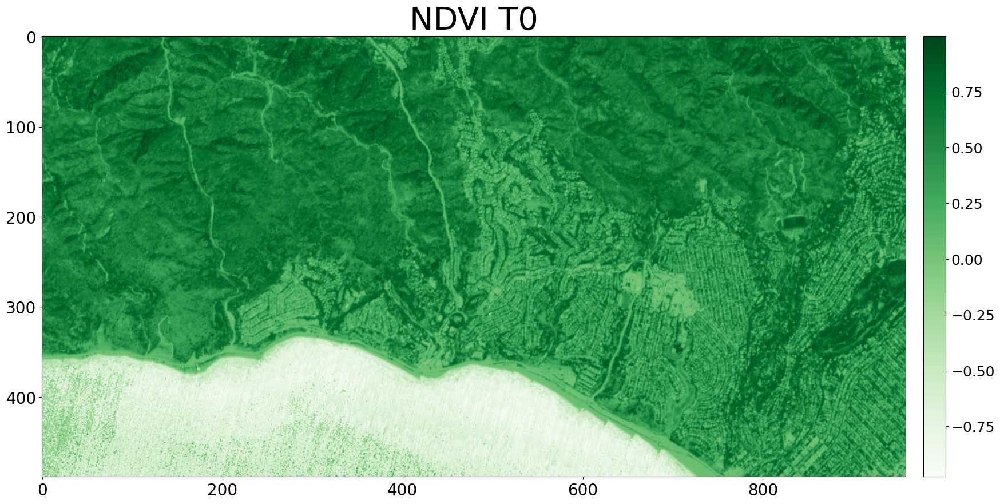

In [74]:
plot_territory(median_ndvi_t0_np, 30, 10, 'Greens', 'NDVI T0')

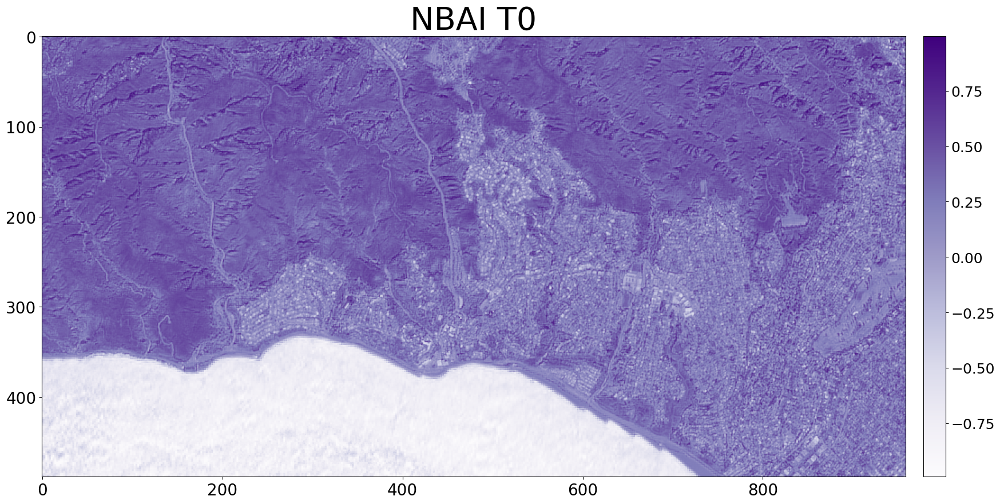

In [75]:
plot_territory(median_nbai_t0_np, 30, 10, 'Reds', 'NBAI T0')

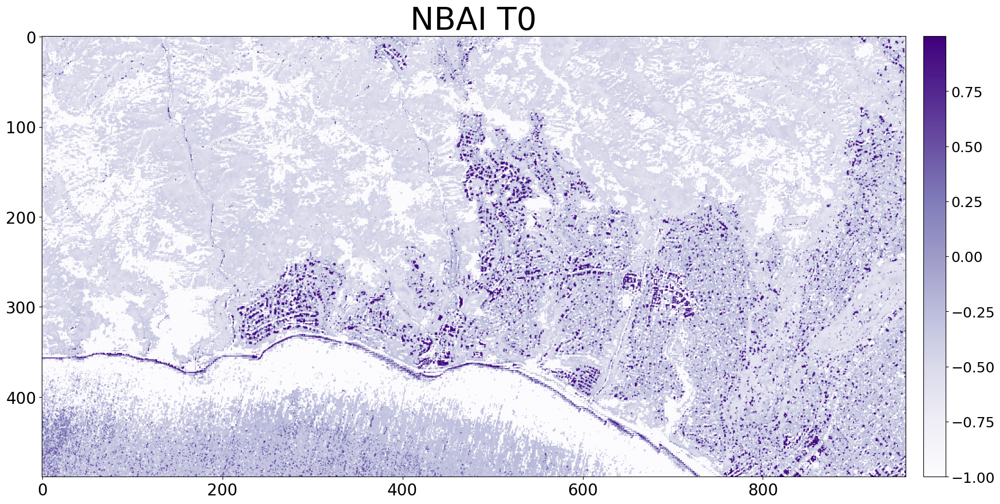

In [76]:
plot_territory(median_ibi_t0_np, 30, 10, 'Purples', 'NBAI T0')

In [ ]:
#building_filter = median_nbai_t0_np < 0.1
#buildings = np.where(building_filter, median_nbas_t0_np, np.nan)
#buildings_water_masked = np.where(np.flipud(water_mask_t1), np.nan, buildings)


In [90]:
building_filter = median_ibi_t0_np > 0
buildings = np.where(building_filter, median_ibi_t0_np, np.nan)
buildings_water_masked = np.where(np.flipud(water_mask_t1), np.nan, buildings)


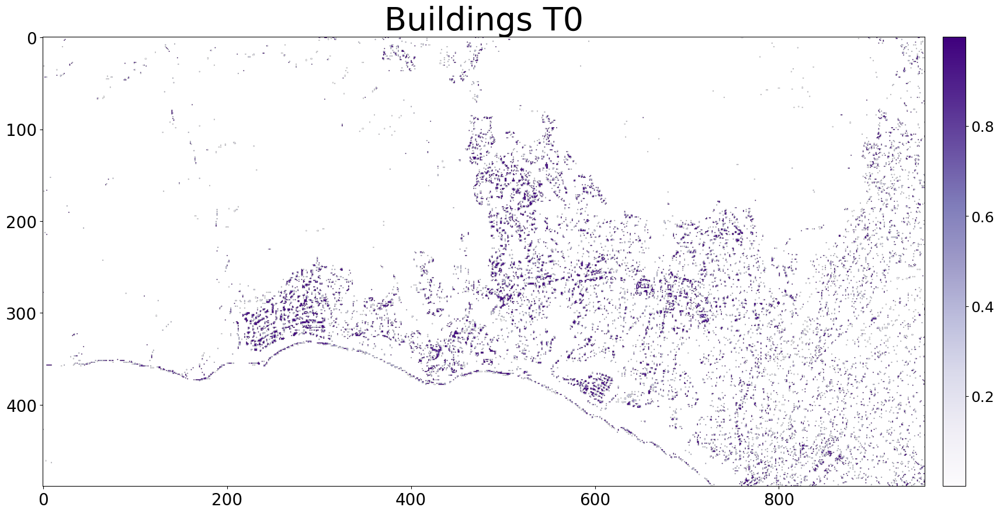

In [91]:
plot_territory(buildings_water_masked, 30, 10, 'Purples', 'Buildings T0')

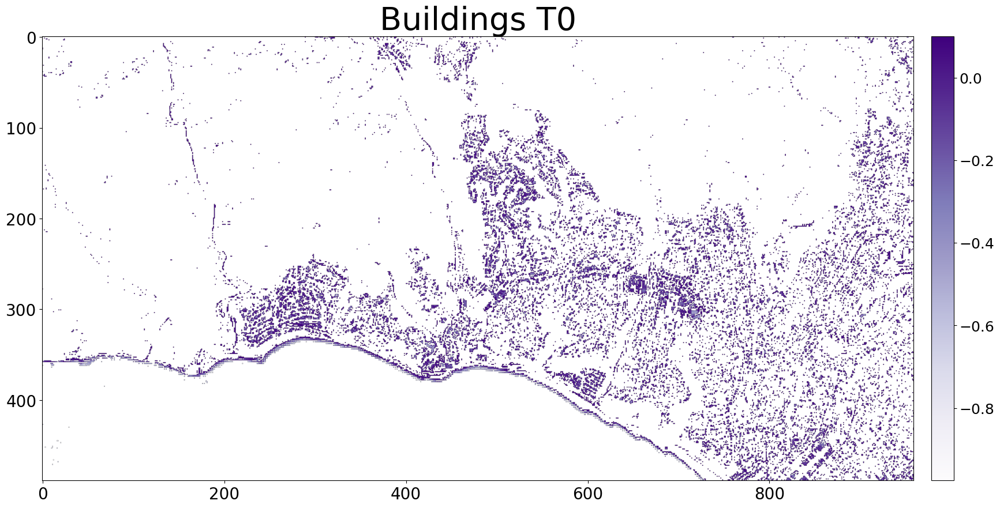

In [69]:
plot_territory(buildings_water_masked, 30, 10, 'Purples', 'Buildings T0')

In [92]:
plot_territory(median_nbrs_t0_np, 30, 10, 'Reds_r', 'NBR T0')

NameError: name 'median_nbrs_t0_np' is not defined

## Calculating the Spectral differences

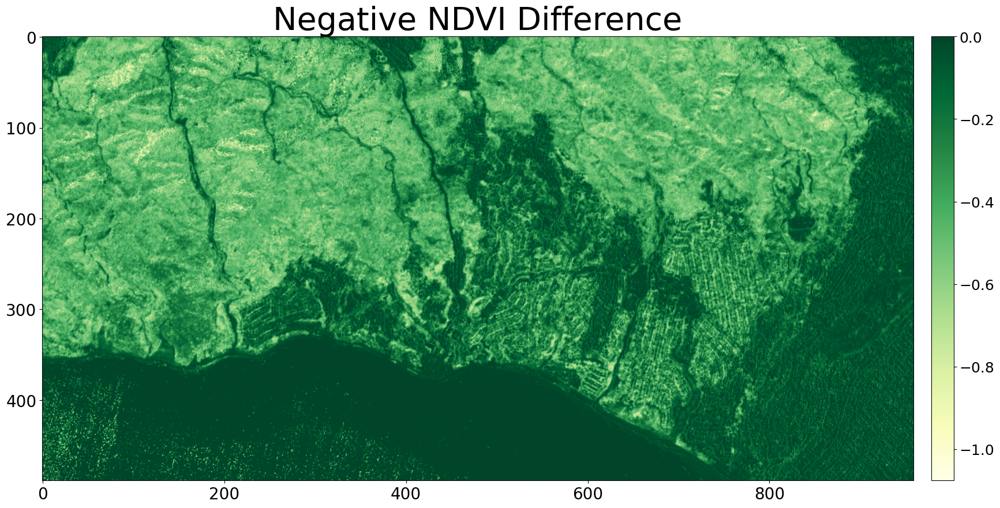

In [71]:
ndvi_difference = median_ndvi_t1 - median_ndvi_t0
ndvi_difference_np = xr_spectral_index_data_to_np(ndvi_difference)
ndvi_difference_np[ndvi_difference_np>0] = 0
plot_territory(ndvi_difference_np, 40, 10, 'YlGn', 'Negative NDVI Difference')

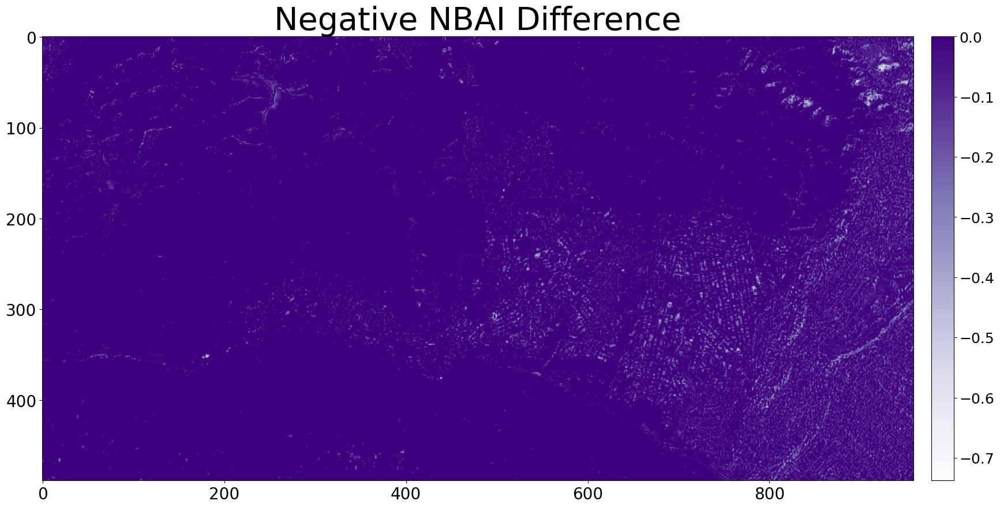

In [72]:
nbai_difference = median_nbai_t1 - median_nbai_t0
nbai_difference_np = xr_spectral_index_data_to_np(nbai_difference)
nbai_difference_np[nbai_difference_np>0] = 0
plot_territory(nbai_difference_np, 40, 10, 'Purples', 'Negative NBAI Difference')

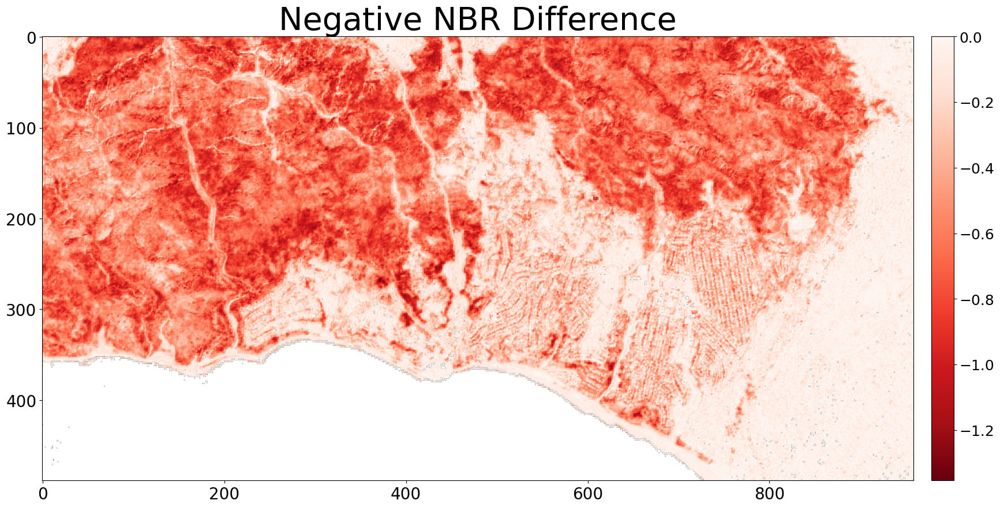

In [73]:
nbrs_difference = median_nbr_t1 - median_nbr_t0
nbrs_difference_np = xr_spectral_index_data_to_np(nbrs_difference)
nbrs_difference_np[nbrs_difference_np>0] = 0
nbrs_difference_np_water_masked = np.where(np.flipud(water_mask_t1), np.nan, nbrs_difference_np)

plot_territory(nbrs_difference_np_water_masked, 40, 10, 'Reds_r', 'Negative NBR Difference')

In [74]:
green = data_t0["green"].astype("float")
swir  = data_t0["swir16"].astype("float")  # SWIR 1 (band 11)

# Compute NDWI (Modified NDWI: using green and SWIR)
ndwi_t0 = (green - swir) / (green + swir)

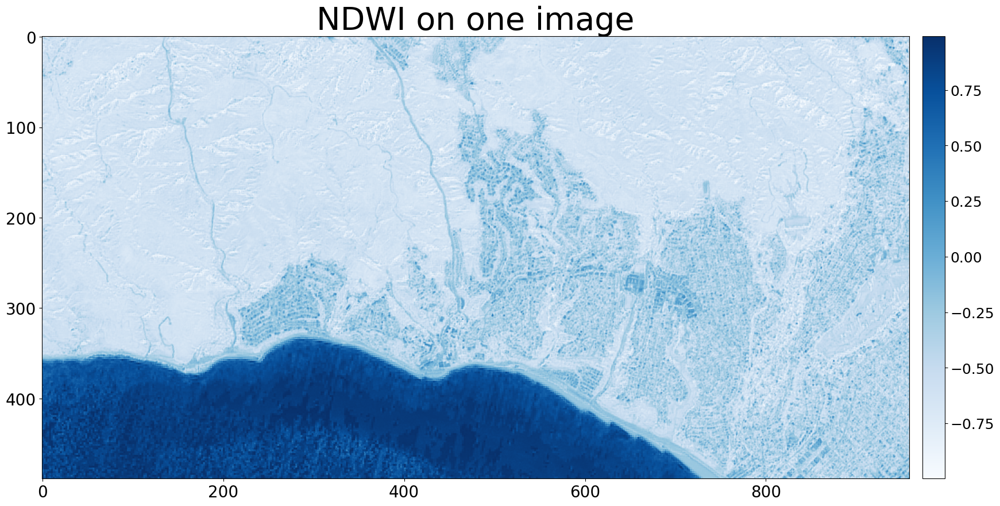

In [75]:
plot_single_image_spectral_idx(ndwi_t0, 30, 10, name = "NDWI", cmap="Blues")

In [76]:
water_mask_t0 = ndwi_t0 > 0
water_mask_t0 = np.flipud(water_mask_t0.to_numpy())

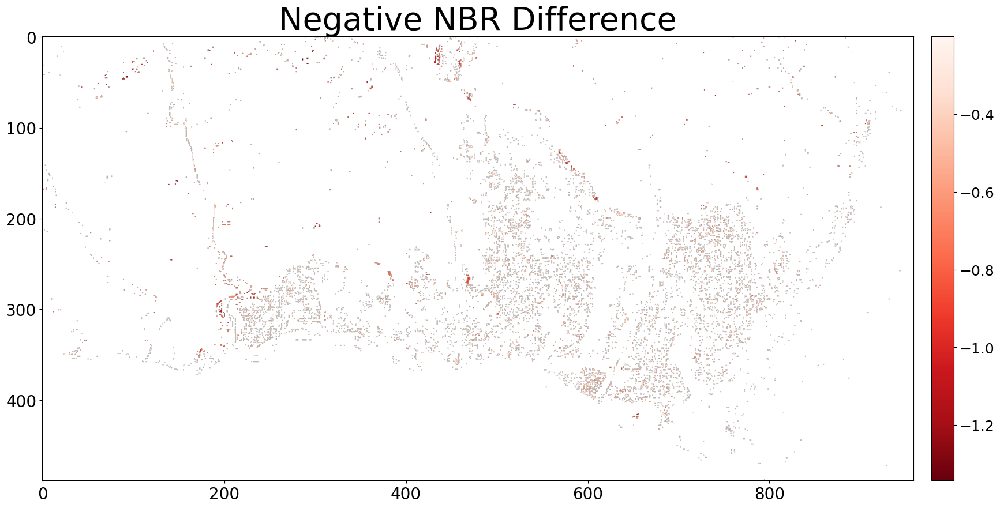

In [77]:
building_mask = np.isnan(buildings)
burned_buildings = np.where(building_mask, np.nan, nbrs_difference_np)
burned_buildings = np.where(nbrs_difference_np < -.2, burned_buildings, np.nan)
burned_buildings = np.where(water_mask_t0, np.nan, burned_buildings)

plot_territory(burned_buildings, 40, 10, 'Reds_r', 'Negative NBR Difference')

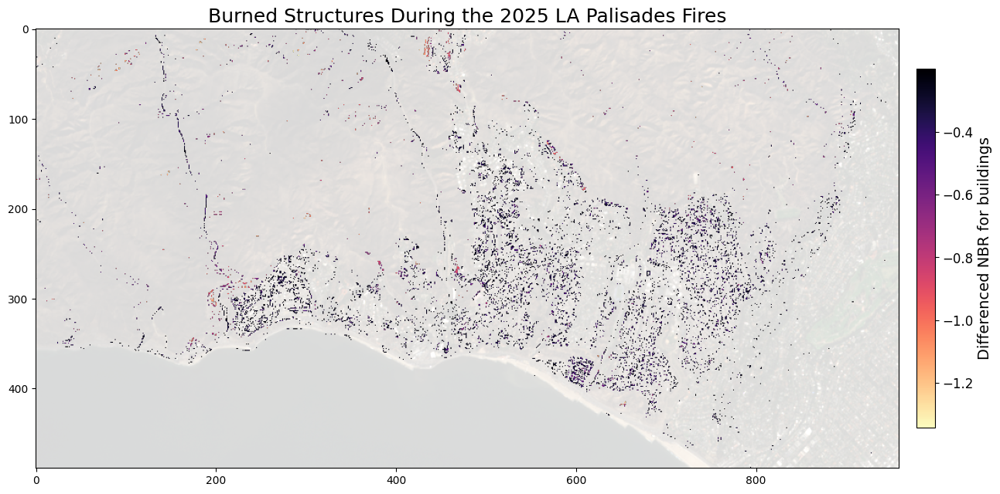

In [78]:
def plot_overlay(
    ax: plt.Axes,
    data: np.ndarray,
    cmap: str = "viridis",
    alpha: float = 0.5
):
    """
    Overlay 'data' on an existing axes (ax) with a chosen colormap and alpha.
    """
    # Optionally flip if you want a certain origin orientation
    data_to_plot = np.flipud(data)

    # Overlay on the existing axes
    overlay = ax.imshow(data_to_plot, cmap=cmap, alpha=alpha)
    return overlay

# Create the figure and plot the base image
fig, ax = plt.subplots(figsize=(15, 15))
base = ax.imshow(normalized_rgb_t1, alpha=0.15)  # The background image
ax.set_title("Burned Structures During the 2025 LA Palisades Fires", size=18)

# Overlay the second dataset on top
overlay = plot_overlay(ax, burned_buildings, cmap="magma_r", alpha=1)

# 4) (Optional) Add a colorbar for the overlay
cbar = plt.colorbar(overlay, ax=ax, fraction=0.02, pad=0.02)
cbar.ax.tick_params(labelsize=12)
cbar.set_label("Differenced NBR for buildings", size=14)
fig.savefig("img/burned_structures_highres.png", dpi=300, bbox_inches="tight")

In [79]:
median_nbais_t0_np.shape

(489, 959)

## Maxar

In [2]:
client = pystac_client.Client.open("https://maxar-opendata.s3.amazonaws.com/events/catalog.json")

/usr/local/Caskroom/miniconda/base/envs/gic-rs/lib/python3.11/site-packages/pystac_client/client.py:190: NoConformsTo: Server does not advertise any conformance classes.
  warnings.warn(NoConformsTo())


In [3]:
client.id

'maxar-opendata'

In [4]:
client.description

'Maxar ARD Open Data Catalog'

In [5]:
collections = list(client.get_collections())
n_collections = len(collections)

/usr/local/Caskroom/miniconda/base/envs/gic-rs/lib/python3.11/site-packages/pystac_client/client.py:440: FallbackToPystac: Falling back to pystac. This might be slow.
  self._warn_about_fallback("COLLECTIONS", "FEATURES")


In [6]:
for c in collections:
    if "24" in c.id or "25" in c.id:
        print(c.id)

Belize-Wildfires-June24
Brazil-Flooding-May24
Floods-Spain-Oct24
HurricaneHelene-Oct24
HurricaneMilton-Oct24
Japan-Earthquake-Jan-2024
Kenya-Flooding-May24
Nepal-Floods-Sept-2024
Nigeria-Floods-Sept-2024
PNG-Landslide-June24
SmokeHouseCreek-Wildfires-Texas-Mar24
WildFires-LosAngeles-Jan-2025


In [7]:
la2025_collection = [c for c in collections if "25" in c.id][0]
la2025_collection

<CollectionClient id=WildFires-LosAngeles-Jan-2025>

In [8]:
date = "2024-12-14/2024-12-31"

In [9]:
la2025_collections = la2025_collection.get_all_collections()
la2025_collections

<generator object Catalog.get_all_collections at 0x15ab9fed0>

In [10]:
collection_t0 = list(la2025_collections)[0]
collection_t0

<CollectionClient id=103001010A705C00>

In [11]:
items = collection_t0.get_all_items()
items

In [12]:
item_list = list(items)

/usr/local/Caskroom/miniconda/base/envs/gic-rs/lib/python3.11/site-packages/pystac_client/collection_client.py:153: FallbackToPystac: Falling back to pystac. This might be slow.
  root._warn_about_fallback("ITEM_SEARCH")


In [13]:
geometries = []
properties_list = []

for item in item_list:
    geometry = shape(item.properties['proj:geometry'])
    geometries.append(geometry)
    properties_list.append(item.properties)

# Create a GeoDataFrame
gdf = gpd.GeoDataFrame(properties_list, geometry=geometries, crs="epsg:32611")
gdf.crs

<Projected CRS: EPSG:32611>
Name: WGS 84 / UTM zone 11N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 120°W and 114°W, northern hemisphere between equator and 84°N, onshore and offshore. Canada - Alberta; British Columbia (BC); Northwest Territories (NWT); Nunavut. Mexico. United States (USA).
- bounds: (-120.0, 0.0, -114.0, 84.0)
Coordinate Operation:
- name: UTM zone 11N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [14]:
m = gdf.to_crs(epsg=4326).explore(column='tile:clouds_area')
m

In [15]:
catalog_ids = gdf.catalog_id.to_list()
len(catalog_ids)

12

In [16]:
len(set(catalog_ids))

1

In [17]:
BASE_URL = "https://maxar-opendata.s3.amazonaws.com/events/WildFires-LosAngeles-Jan-2025/ard/"

In [74]:
item0 = item_list[4]

In [75]:
datetime.strptime(item0.properties['datetime'], '%Y-%m-%d %H:%M:%SZ')

datetime.datetime(2024, 12, 14, 18, 53, 50)

In [76]:
item0

<Item id=11/031311102012/103001010A705C00>

In [77]:
# Choose an asset. Here we use the 'visual' asset if available, otherwise the first asset.
def get_maxar_url(item, asset_type:str="visual"):
    asset_tiff_href = item0.assets.get(asset_type, list(item0.assets.values())[0]).href
    asset_tiff_href = asset_tiff_href.lstrip(".")
    quad_key = item0.properties['quadkey']
    utm_zone = item0.id.split("/")[0]
    item_date = datetime.strptime(item0.properties['datetime'], '%Y-%m-%dT%H:%M:%SZ').strftime('%Y-%m-%d')#datetime.strptime(item0.properties['datetime'], '%Y-%m-%dT%H:%M:%SZ').strftime('%Y-%m-%d')
    asset_href = BASE_URL + utm_zone + "/" + quad_key + "/" + item_date + asset_tiff_href
    return asset_href

In [78]:
asset_href = get_maxar_url(item0, "visual")

In [79]:
item0

<Item id=11/031311102012/103001010A705C00>

In [80]:
import matplotlib.pyplot as plt

with rasterio.open(f"/vsicurl/{asset_href}") as src:
    img = src.read([1, 2, 3])

In [81]:
# Transpose the image data to be in the correct shape (height, width, bands)
img_rgb = np.moveaxis(img, 0, -1)


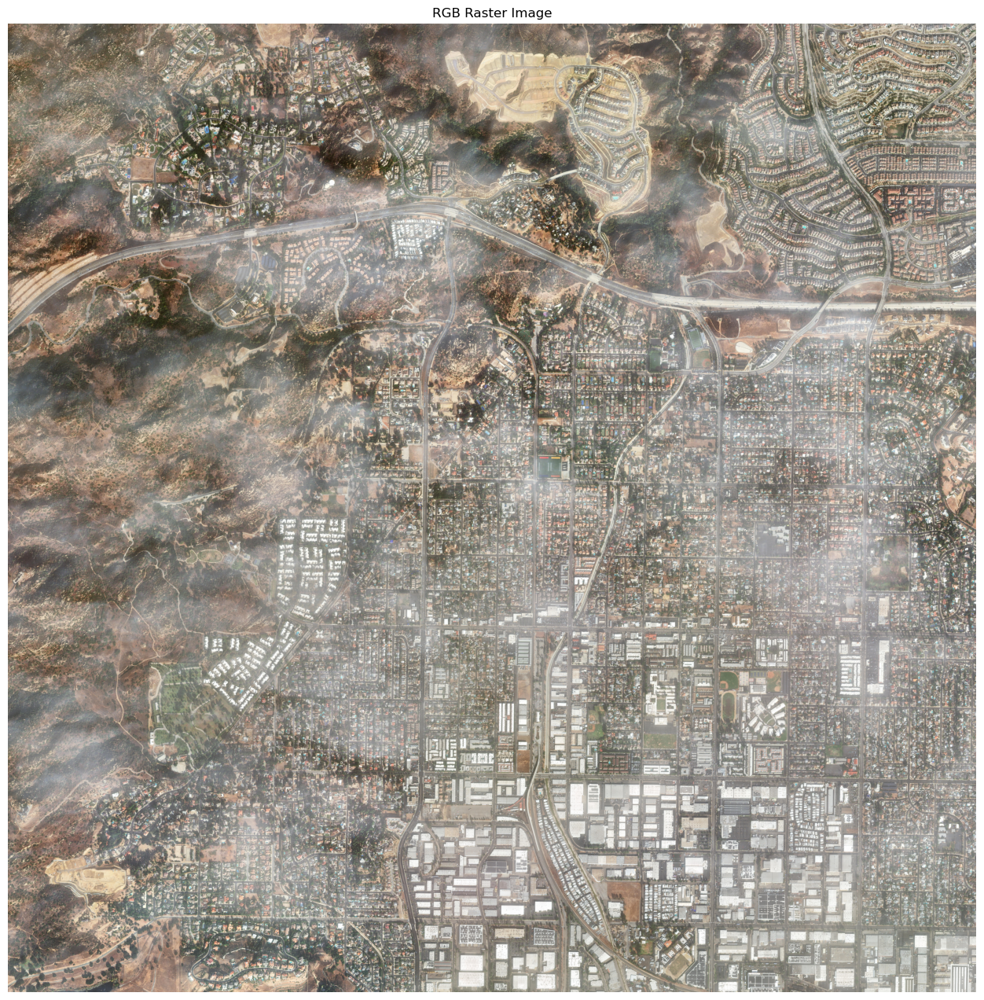

In [82]:
# Plot the RGB image using matplotlib
plt.figure(figsize=(20, 16))
plt.imshow(img_rgb)
plt.title('RGB Raster Image')
plt.xlabel('X Coordinate')
plt.ylabel('Y Coordinate')
plt.axis('off')  # Optionally turn off axis numbers and ticks
plt.show()

In [84]:
asset_href = get_maxar_url(item0, "ms_analytic")

In [90]:
with rasterio.open(f"/vsicurl/{asset_href}") as src:
    img_8band = src.read(list(range(1,9)))

In [92]:
img_8band.shape

(8, 2372, 2372)

In [95]:
item0.

{'data-mask': <Asset href=./103001010A705C00-data-mask.gpkg>,
 'ms_analytic': <Asset href=./103001010A705C00-ms.tif>,
 'pan_analytic': <Asset href=./103001010A705C00-pan.tif>,
 'visual': <Asset href=./103001010A705C00-visual.tif>}

In [96]:
item0.get_assets("ms_analytic")

{}